**Identifikasi Penyakit Daun pada Tanaman Stroberi**

Eksplorasi Sampel Data

In [2]:
from google.colab import drive
drive.mount('/content/drive')

# Path dataset
path = "/content/drive/MyDrive/PCD/Tugas Akhir"

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [3]:
# Menyiapkan direktori kerja
import os

os.chdir(path)
os.getcwd()

'/content/drive/MyDrive/PCD/Tugas Akhir'

In [4]:
# Library
import numpy as np
import cv2
from matplotlib import pyplot as plt
import pywt
from pywt._doc_utils import wavedec2_keys, draw_2d_wp_basis
from scipy.fft import fft, rfft
from scipy.fft import fftfreq, rfftfreq
%matplotlib inline

In [5]:
# Read image
train_dir = os.path.join(path, 'data_train')
testing_dir = os.path.join(path, 'data_testing')

# Direktori training strawberry healthy
train_healthy_dir = os.path.join(train_dir, 'Strawberry_healthy')

# Direktori training strawberry scorch
train_scorch_dir = os.path.join(train_dir, 'Strawberry_scorch')

# Direktori testing strawberry healthy
test_healthy_dir = os.path.join(testing_dir, 'Strawberry_healthy')

# Direktori testing strawberry scorch
test_scorch_dir = os.path.join(testing_dir, 'Strawberry_scorch')

In [12]:
# Cek nama file image
train_healthy_snames = ['Strawberry_healthy{}.jpg'.format(i) for i in range(1, 61)]
train_scorch_snames = ['Strawberry_Leaf_scorch{}.jpg'.format(i) for i in range(1, 61)]

print(train_healthy_snames[:10])
print(train_scorch_snames[:10])


['Strawberry_healthy1.jpg', 'Strawberry_healthy2.jpg', 'Strawberry_healthy3.jpg', 'Strawberry_healthy4.jpg', 'Strawberry_healthy5.jpg', 'Strawberry_healthy6.jpg', 'Strawberry_healthy7.jpg', 'Strawberry_healthy8.jpg', 'Strawberry_healthy9.jpg', 'Strawberry_healthy10.jpg']
['Strawberry_Leaf_scorch1.jpg', 'Strawberry_Leaf_scorch2.jpg', 'Strawberry_Leaf_scorch3.jpg', 'Strawberry_Leaf_scorch4.jpg', 'Strawberry_Leaf_scorch5.jpg', 'Strawberry_Leaf_scorch6.jpg', 'Strawberry_Leaf_scorch7.jpg', 'Strawberry_Leaf_scorch8.jpg', 'Strawberry_Leaf_scorch9.jpg', 'Strawberry_Leaf_scorch10.jpg']


In [13]:
# Menghitung banyak file input
print('Total training healthy strawberry images:', len(os.listdir(train_healthy_dir)))
print('Total training scorch strawberry images:', len(os.listdir(train_scorch_dir)))
print('Total testing healthy strawberry images:', len(os.listdir(test_healthy_dir)))
print('Total testing scorch strawberry images:', len(os.listdir(test_scorch_dir)))

Total training healthy strawberry images: 50
Total training scorch strawberry images: 50
Total testing healthy strawberry images: 10
Total testing scorch strawberry images: 10


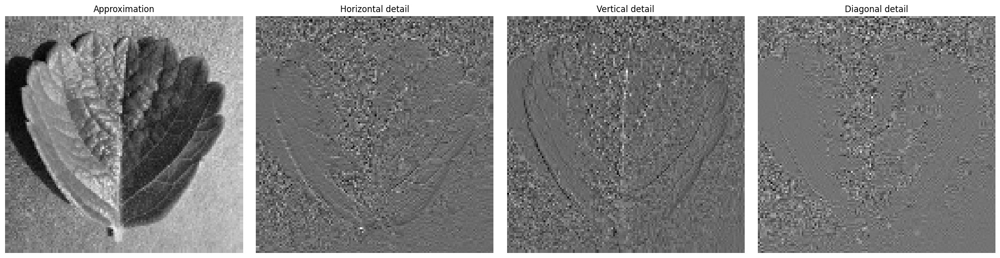

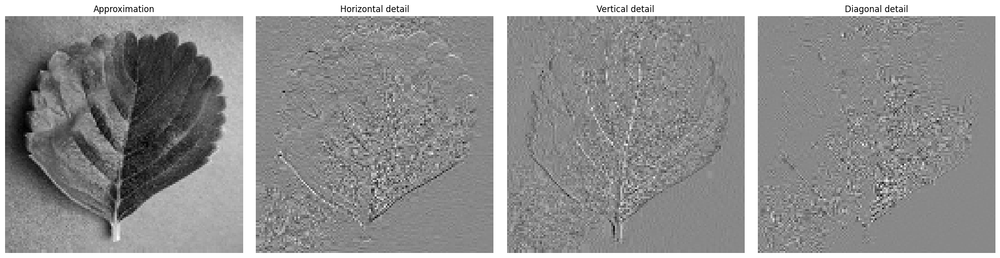

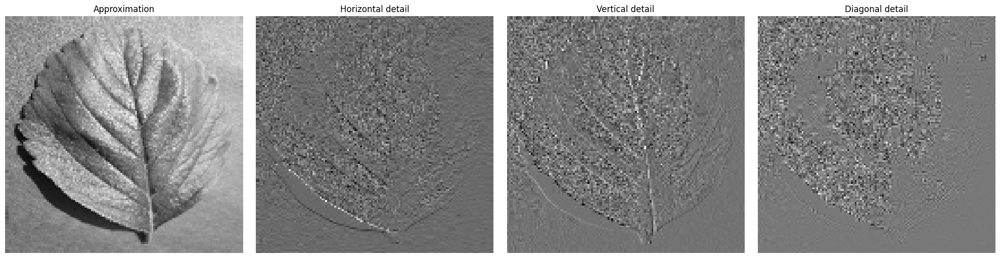

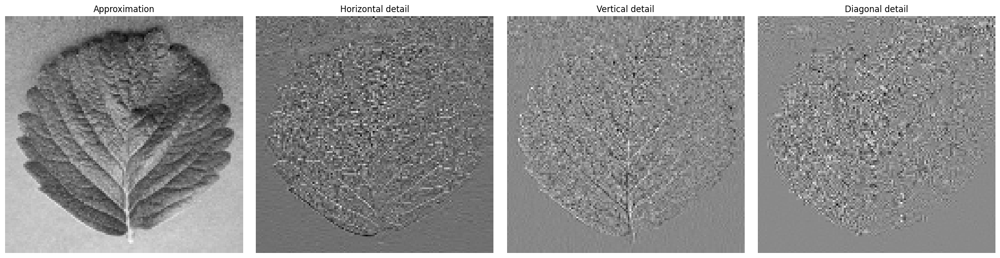

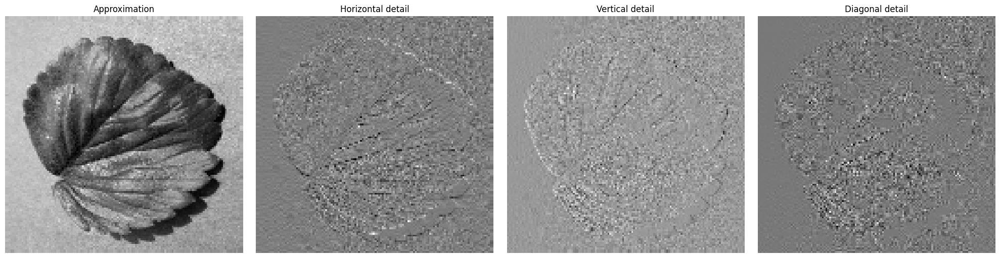

...

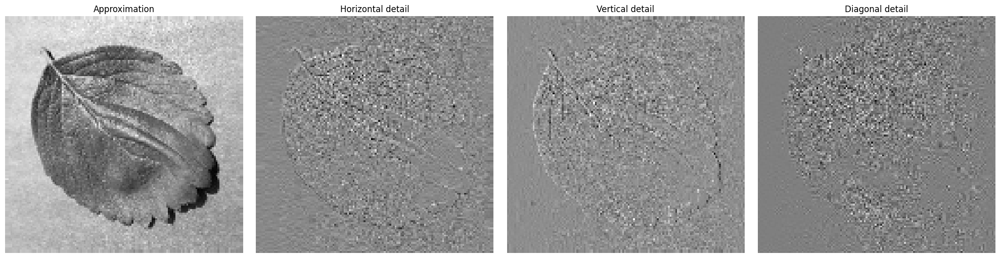

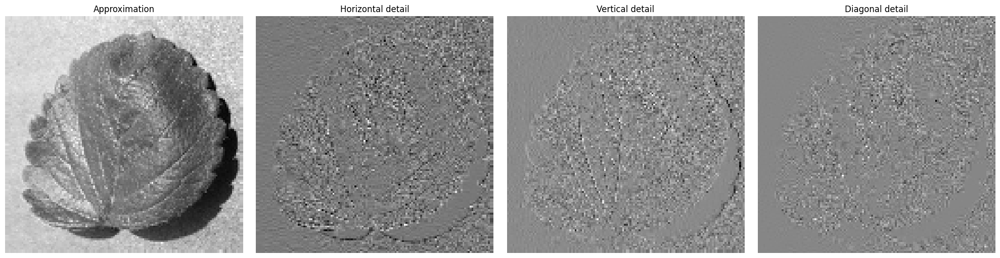

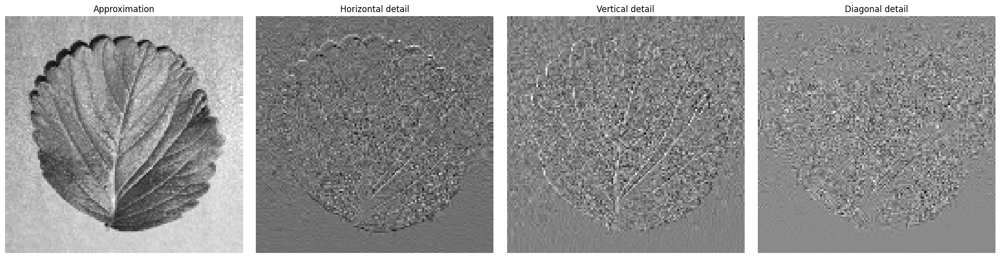

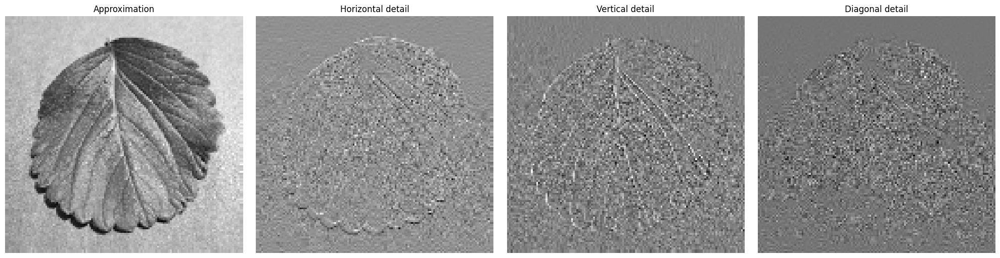

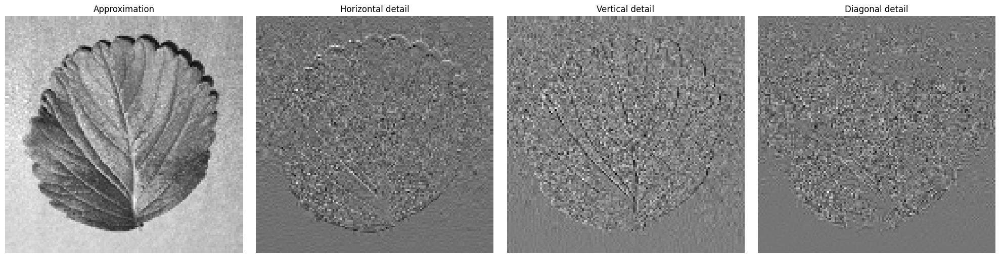

In [8]:
# Fungsi untuk melakukan wavelet transform
def perform_wavelet_transform(image_path):
   # Membaca image dalam mode grayscale
    img = cv2.imread(image_path, 0) 

    # Melakukan wavelet transform dengan metode 'bior1.3'
    coeffs = pywt.dwt2(img, 'bior1.3')  
    return coeffs

# Fungsi untuk menampilkan plot hasil wavelet transform
def plot_wavelet_coeffs(coeffs):
    LL, (LH, HL, HH) = coeffs

    titles = ['Approximation', 'Horizontal detail', 'Vertical detail', 'Diagonal detail']

    fig, axes = plt.subplots(1, 4, figsize=(20, 5))

    for i, a in enumerate([LL, LH, HL, HH]):
        axes[i].imshow(a, interpolation="nearest", cmap=plt.cm.gray)
        axes[i].set_title(titles[i])
        axes[i].axis('off')

    plt.tight_layout()
    plt.show()

# Melakukan wavelet transform pada images di direktori train_healthy_dir
train_healthy_coeffs = []
for filename in os.listdir(train_healthy_dir):
    if filename.endswith('.jpg'):
        image_path = os.path.join(train_healthy_dir, filename)
        try:
            coeffs = perform_wavelet_transform(image_path)
            train_healthy_coeffs.append(coeffs)
            plot_wavelet_coeffs(coeffs)
        except ValueError as e:
            print(str(e))

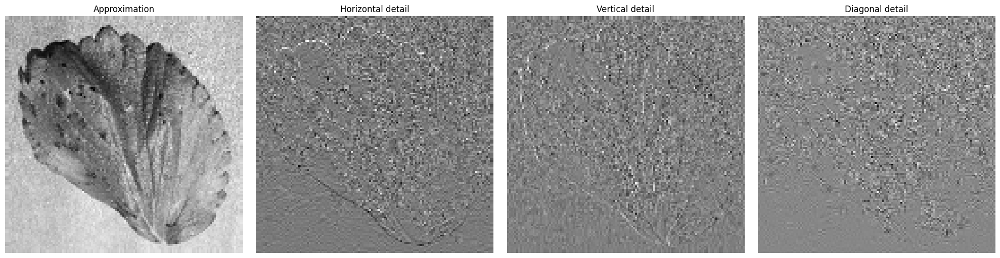

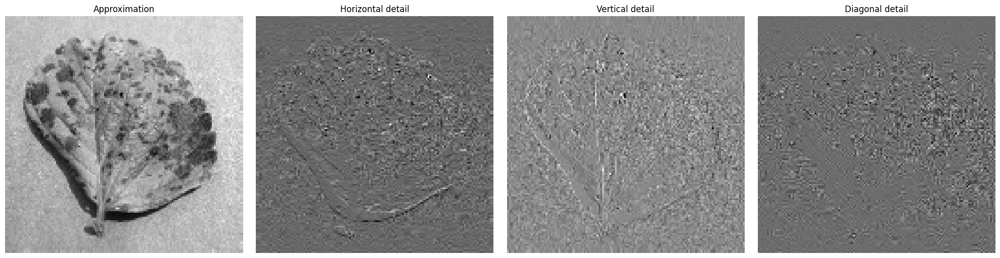

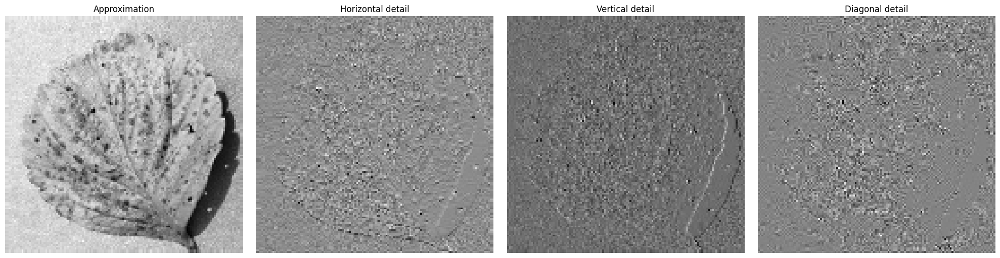

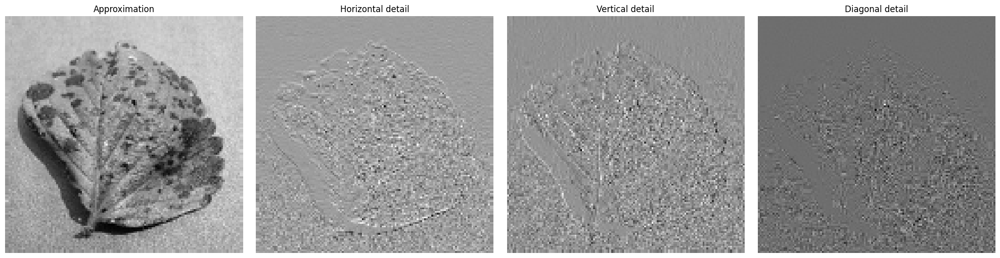

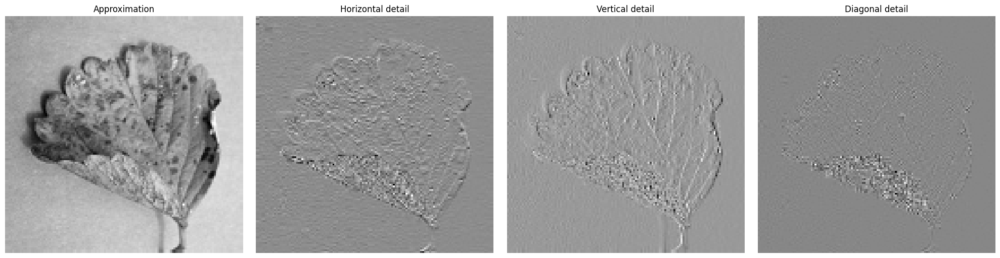

...

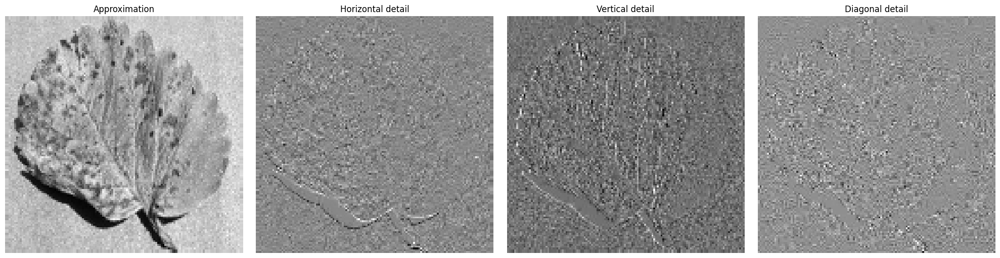

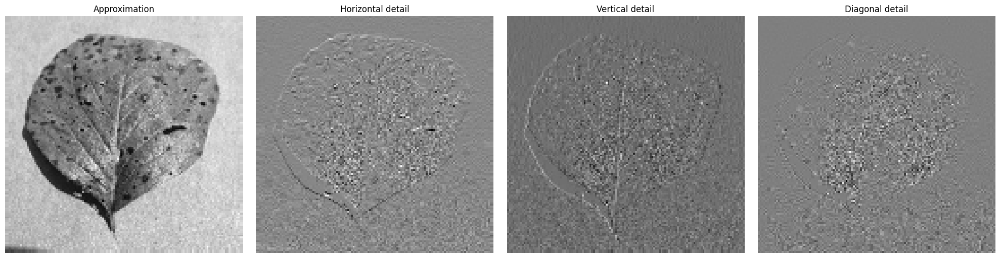

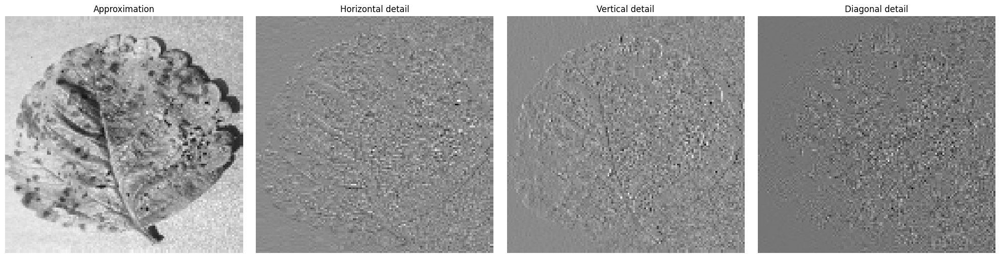

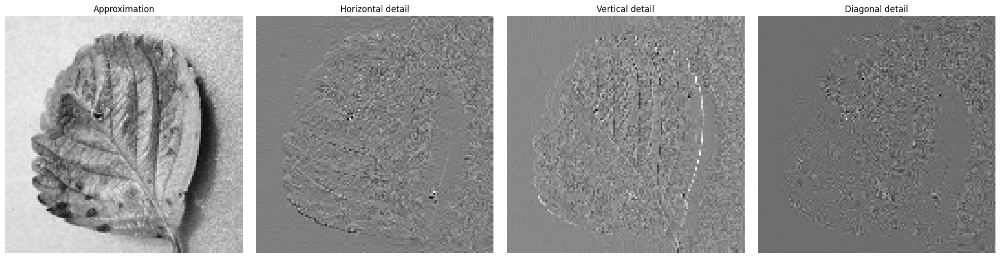

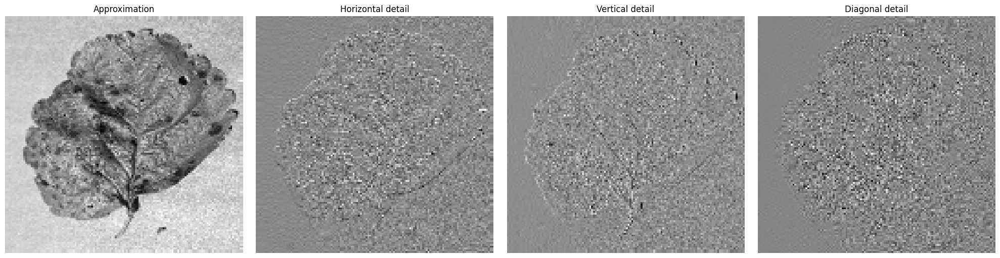

In [7]:
# Melakukan wavelet transform pada images di direktori train_scorch_dir
train_scorch_coeffs = []
for filename in os.listdir(train_scorch_dir):
    if filename.endswith('.jpg'):
        image_path = os.path.join(train_scorch_dir, filename)
        try:
            coeffs = perform_wavelet_transform(image_path)
            train_scorch_coeffs.append(coeffs)
            plot_wavelet_coeffs(coeffs)
        except ValueError as e:
            print(str(e))